# Import Essential Libraries...

In [1]:
import os
import cv2
import numpy as np
from scipy import signal, ndimage
import matplotlib.pyplot as plt
# %matplotlib inline

Always try to build a frame for the code and then develop on it.

## Helper functions

In [19]:
def img2vid(img_folder_path="../data/all-frames-colour/Urban2/", generated_vid_path="../data/all-frames-colour/Urban2/Urban2.mp4", fps=2):
    """
    Construct Video from Images.
    Inputs:
        img_folder_path: Path for Images.
        generated_vid_path: Path from which video is taken.
        fps: Frame Per Sec.
        e.g., fps=1 => 1 frame per sec, while fps=0.5 => 0.5 frames per sec => 1 frame per 2 sec
    """
    # Collect Image Names
    file_names = [os.path.join(img_folder_path, f) for f in os.listdir(img_folder_path) if os.path.isfile(os.path.join(img_folder_path, f))]
    # print(int(file_names[0].split(".png")[0][-2:]))
    file_names.sort(key = lambda x:int(x.split(".jpg")[0][-1:]), reverse=False)
    # Read above Images and save them in a list.
    frame_arr = []
    for file in file_names:
        img = cv2.imread(file)
        frame_arr.append(img)
    img_shape = (img.shape[1], img.shape[0])# (width, height)
    # Create a Videowriter Object to concat the frames to generate video along time dimension.
    out = cv2.VideoWriter(generated_vid_path, cv2.VideoWriter_fourcc(*'MJPG'), fps, img_shape)
    #also *'DIVX' can be used
    for i in range(len(frame_arr)):
        # writing to a image array
        out.write(frame_arr[i])
    out.release()

def videoMaker(video_path, output_path):
    """
    Construct Video from Images.
    Inputs:
        img_folder_path: Path for Images.
        generated_vid_path: Path from which video is taken.
        fps: Frame Per Sec.
        e.g., fps=1 => 1 frame per sec, while fps=0.5 => 0.5 frames per sec => 1 frame per 2 sec
    """
    cap = cv2.VideoCapture(video_path)
    # get frame rate of video.
    fps = cap.get(cv2.CAP_PROP_FPS)
    # Take first frame and find corners in it
    ret, prev = cap.read()
    prevgray = cv2.cvtColor(prev, cv2.COLOR_BGR2GRAY)
    out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*'MJPG'), fps, (prev.shape[1], prev.shape[0]))
    #also *'DIVX' can be used
    
    while (cap.isOpened()):
        ret, frame = cap.read()
        if ret == True:
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            # calculate optical flow
            u, v = LukasKanadeForwardAdditive(prevgray, gray, 70, 0.01)
            # Add quivers to the image.
            img_new = addQuivers(u, v, prev)
            # Now update the previous frame and previous points
            prevgray = gray.copy()
            prev = frame.copy()
            # write the images into a video file...
            out.write(img_new)
        else:
            break
    out.release()
    cap.release()

# Show the colored or Gray-Scale image.
def show_img(image, title, show_shape=True, shape=(10, 8), lim_enabled=False):
    if show_shape:
        print(f"The shape of {title} Image = {image.shape}")
    if image.ndim == 3:
        plt.figure(figsize=shape)
        plt.imshow(image[:,:,::-1]); plt.axis("off"); plt.title(title); plt.show()
    elif image.ndim == 2:
        plt.figure(figsize=shape)
        if lim_enabled:
            plt.imshow(image, cmap = "gray", vmin = 0, vmax = 255); plt.axis("off"); plt.title(title); plt.show()
        else:
            plt.imshow(image, cmap = "gray"); plt.axis("off"); plt.title(title); plt.show()
    else:
        raise ValueError("Incorrect Dimension")
        
# Plot a sequence of image
def plotter(nrows, ncols, img_lst, titles_lst, mode='RGB', figsize = (20, 20), lim_enabled = False):
    fig, ax = plt.subplots(nrows, ncols, figsize = figsize); k = 0
    for i in range(nrows):
        for j in range(ncols):
            if mode == 'RGB':
                if nrows == 1:
                    ax[j].imshow(cv2.cvtColor(img_lst[k], cv2.COLOR_BGR2RGB))
                    ax[j].axis("off")
                    ax[j].set_title(titles_lst[k])
                elif ncols == 1:
                    ax[i].imshow(cv2.cvtColor(img_lst[k], cv2.COLOR_BGR2RGB))
                    ax[i].axis("off")
                    ax[i].set_title(titles_lst[k])
                else:
                    ax[i, j].imshow(cv2.cvtColor(img_lst[k], cv2.COLOR_BGR2RGB))
                    ax[i, j].axis("off")
                    ax[i, j].set_title(titles_lst[k])
            else:
                if nrows == 1:
                    if lim_enabled:
                        ax[j].imshow(img_lst[k], cmap = "gray", vmin = 0, vmax = 255)
                    else:
                        ax[j].imshow(img_lst[k], cmap = "gray")
                    ax[j].axis("off")
                    ax[j].set_title(titles_lst[k])
                elif ncols == 1:
                    if lim_enabled:
                        ax[i].imshow(img_lst[k], cmap = "gray", vmin = 0, vmax = 255)
                    else:
                        ax[i].imshow(img_lst[k], cmap = "gray")
                    ax[i].axis("off")
                    ax[i].set_title(titles_lst[k])
                else:
                    if lim_enabled:
                        ax[i,j].imshow(img_lst[k], cmap = "gray", vmin = 0, vmax = 255)
                    else:
                        ax[i,j].imshow(img_lst[k], cmap = "gray")
                    ax[i, j].axis("off")
                    ax[i, j].set_title(titles_lst[k])
            k += 1
    fig.tight_layout(rect = [0,0,1,0.95])
    plt.show()
    
# Convert to GRAY scale
def gray(image): return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Plot the quivers for OF
def plot_flow(img, u, v, features, save=False, name="rodo.png"):
    """
    plot the flow for stereo pairs Img1 and IMg2 with arrows only on IMage1
    Note: if u are feeding features from any Cv2 funcions then flip x and y coords.
    """
    U = [u[pts[0], pts[1]] for pts in features]
    V = [-v[pts[0], pts[1]] for pts in features]
    plt.figure(figsize=(20,10))
    plt.imshow(img)
    # print(U, V)
    plt.quiver(features[:, 1], features[:, 0], np.asarray(U), np.asarray(V), color='#1ed115', headlength=2, headaxislength=3)#, scale=0.5  
    if save:
        plt.savefig(name, dpi=100)
    plt.show()
    return img

def plot_flow_in_row(img_lst, u_lst, v_lst, features_lst, names_lst):
    """
    plot the flow for stereo pairs Img1 and IMg2 with arrows only on IMage1
    Note: if u are feeding features from any Cv2 funcions then flip x and y coords.
    """
    fig, ax = plt.subplots(nrows=1, ncols=len(img_lst), figsize=(20, 15))
    for k, (u, v, img, features) in enumerate(zip(u_lst, v_lst, img_lst, features_lst)):
        U = [u[pts[0], pts[1]] for pts in features]
        V = [-v[pts[0], pts[1]] for pts in features]
        ax[k].imshow(img)
        # print(U, V)
        ax[k].quiver(features[:, 1], features[:, 0], np.asarray(U), np.asarray(V), color='#1ed115', headlength=2, headaxislength=3)#, scale=0.5 
        ax[k].set_title(names_lst[k]); ax[k].set_axis_off()
    fig.tight_layout(rect = [0,0,1,0.95])
    plt.show()
    
def plot_flow_in_rowandcol(img_lst, u_lst, v_lst, features_lst, names_lst):
    """
    plot the flow for stereo pairs Img1 and IMg2 with arrows only on IMage1
    Note: if u are feeding features from any Cv2 funcions then flip x and y coords.
    """
    fig, ax = plt.subplots(nrows=len(img_lst)//3, ncols=3, figsize=(20, 10))
    for k, (u, v, img, features) in enumerate(zip(u_lst, v_lst, img_lst, features_lst)):
        U = [u[pts[0], pts[1]] for pts in features]
        V = [-v[pts[0], pts[1]] for pts in features]
        ax[k//3, k%3].imshow(img)
        # print(U, V)
        ax[k//3, k%3].quiver(features[:, 1], features[:, 0], np.asarray(U), np.asarray(V), color='#1ed115', headlength=2, headaxislength=3)#, scale=0.5 
        ax[k//3, k%3].set_title(names_lst[k]); ax[k//3, k%3].set_axis_off()
    fig.tight_layout(rect = [0,0,1,0.95])
    plt.show()

# 2.1 Keypoint Selection: Selecting Pixels to Track

Implement (i) Harris Corner Detector and (ii) Shi-Tomasi Corner Detector and visualize the feature set of pixels obtained by both algorithms that will be
tracked by the sparse LK method. Visualize the detected pixels superimposed on the images for at least one image from each of the given sequences.

This part of the assignment is based on the 1988 work, A Combined Corner and Edge Detector, by Chris Harris and Mike Stephens, and 1994 CVPR paper, Good Features to Track, by Jianbo Shi and Tomasi.

In [6]:
def calculate_gradients(gray):
    """Calculate gardients of image using Sobel filter."""
    smoothed_image = cv2.GaussianBlur(gray, (5,5), (5-1)/6)
    # Calculation of Sobelx
    Ix = cv2.Sobel(smoothed_image, cv2.CV_64F, 1, 0, ksize=3).astype(np.float64)
    # Calculation of Sobely
    Iy = cv2.Sobel(smoothed_image, cv2.CV_64F, 0, 1, ksize=3).astype(np.float64)
    # Ixx, Ixy, Iyy = Ix**2, Ix*Iy, Iy**2
    Ixx = cv2.GaussianBlur(Ix**2, (5,5), (5-1)/6)
    Ixy = cv2.GaussianBlur(Ix*Iy, (5,5),  (5-1)/6)
    Iyy = cv2.GaussianBlur(Iy**2, (5,5),  (5-1)/6)
    return Ixx, Ixy, Iyy

def plot_corners_over_image(img, corners, plot=True):
    """Plot circles on interest points of the image."""
    plot_img = img.copy()
    for corner in corners:
        cv2.circle(plot_img, corner, 2, (0, 255, 0), -1)
    if plot:
        plt.figure(figsize=(20, 10))
        plt.imshow(plot_img)
        plt.show()
    return plot_img

def filter_corners(response_img, thresh):
    """Creates a mask that filters out corners from the image."""
    _, mask = cv2.threshold(response_img, thresh, 255, cv2.THRESH_BINARY)
    return mask.astype(np.uint8)

def get_feature_coord(mask):
    """Through contours try to find the co-ordinates of the interesting image point."""
    corners = list()
    contours, hierarchy = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    for contour in contours:
        x,y,w,h = cv2.boundingRect(contour)
        mid = (int(x+w/2), int(y+h/2))
        corners.append(mid)
    return corners

def harris_corner_detector(gray_img, plot=False, col_img=None):
    """Harris corner detection."""
    Ixx, Ixy, Iyy = calculate_gradients(gray_img)
    print("HArris\n")
    print(f"mAx = {np.max(Ixx)}, {np.max(Ixy)}, {np.max(Iyy)}")
    det = Ixx*Iyy - Ixy**2
    print(f"det max = {np.max(det)}")
    trace = Ixx + Iyy
    response_img = np.divide(det, trace)
    response_img = cv2.dilate(response_img, None)
    mask = filter_corners(response_img, 850)
    corners = get_feature_coord(mask)
    if plot:
        _ = plot_corners_over_image(col_img, corners)
    return corners

def shi_tomasi_corner_detector(gray_img, plot=False, col_img=None):
    """Shi-tomasi corner detection."""
    Ixx, Ixy, Iyy = calculate_gradients(gray_img)
    print("ST:::\n")
    print(f"mAx = {np.max(Ixx)}, {np.max(Ixy)}, {np.max(Iyy)}")
    det = Ixx*Iyy - Ixy**2
    print(f"det max = {np.max(det)}")
    trace = Ixx + Iyy
    response_img = (trace - np.abs(np.sqrt(trace**2 - 4*det)))/2.
    response_img = cv2.dilate(response_img, None)
    mask = filter_corners(response_img, 850)
    corners = get_feature_coord(mask)
    if plot:
        _ = plot_corners_over_image(col_img, corners)
    return corners

In [128]:
# read the images and find the interesting points...
fold_lst = ["RubberWhale", "Urban2", "Grove3"]
col_lst = [cv2.imread(f"../data/all-frames-colour/{fold_names}/frame07.png") for fold_names in fold_lst]#[:,:,::-1]
gray_lst = [gray(col_lst[i]) for i in range(3)]

In [129]:
# Implement Harris Corner Detection and Shi-tomasi
harris_img = [plot_corners_over_image(col_lst[imm], harris_corner_detector(gray_lst[imm], plot=False), plot=False) for imm in range(3)]
st_img = [plot_corners_over_image(col_lst[imm], shi_tomasi_corner_detector(gray_lst[imm], plot=False), plot=False) for imm in range(3)]

HArris

mAx = 173998.64582099442, 85386.4156229924, 225713.77283698163
det max = 2896770876.745303
HArris

mAx = 80552.0787088584, 28301.440855420606, 157688.157862565
det max = 737903339.1094841
HArris

mAx = 411927.15168785024, 171131.94138326505, 345587.55550713267
det max = 12017385248.264996
ST:::

mAx = 173998.64582099442, 85386.4156229924, 225713.77283698163
det max = 2896770876.745303
ST:::

mAx = 80552.0787088584, 28301.440855420606, 157688.157862565
det max = 737903339.1094841
ST:::

mAx = 411927.15168785024, 171131.94138326505, 345587.55550713267
det max = 12017385248.264996


/tmp/ipykernel_33362/1276855589.py:48: RuntimeWarning: invalid value encountered in true_divide
  response_img = np.divide(det, trace)
/tmp/ipykernel_33362/1276855589.py:64: RuntimeWarning: invalid value encountered in sqrt
  response_img = (trace - np.abs(np.sqrt(trace**2 - 4*det)))/2.


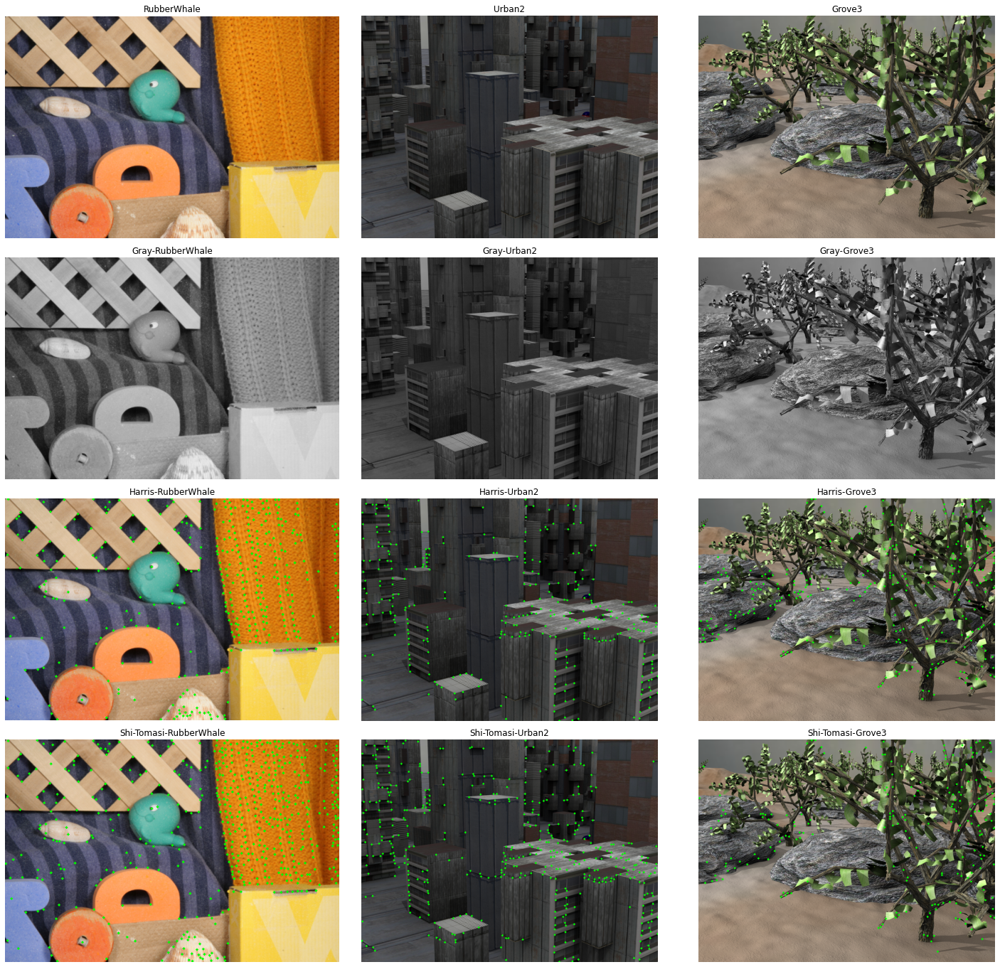

In [130]:
title_lst = fold_lst+["Gray-"+k for k in fold_lst]+["Harris-"+k for k in fold_lst]+["Shi-Tomasi-"+k for k in fold_lst]
plotter(4, 3, col_lst+gray_lst+harris_img+st_img, title_lst, mode='RGB', figsize = (20, 20), lim_enabled = False)

# 2.2 Forward-Additive Sparse Optical Flow

Implement the single-scale Lukas-Kanade (LK) algorithm based on the work described in the classic 1981 IJCAI paper An iterative image registration technique with an application to stereo vision by Bruce D. Lucas and Takeo Kanade. This involves finding the motion (u, v) that minimizes the sum-squared error of the brightness constancy equations for each pixel in a window. Your algorithm will be implemented as a function with the following inputs:

`LukasKanadeForwardAdditive(Img1, Img2, windowSize)`

##### Gaussain smoothing + two-sided derivative = sobel filtering:

Read this [Blog](https://towardsdatascience.com/image-derivative-8a07a4118550)

__Lucas-Kanade Algorithm (ON SPARSE POINTS):__

In [11]:
def boundary_check(x, y, w, img_shape):
    """
    x: x-coordinate
    y: y-coordinate
    w: half of window size
    img_shape: Image width and Height
    
    Output:
        boolean --> whether point is at boundary or not.
    """
    if (x-w)<=0 or (y-w)<=0 or (x+w)>=img_shape[0] or (y+w)>=img_shape[1]:
        return True
    return False

def LukasKanadeForwardAdditive(Img1, Img2, features, windowSize, u_and_v=None, tau=0.01):
    """
    (Ensure both images to be single channel)
    Input:
        Img1: Image taken at time = t
        Img2: Image taken at time = t+1
        windowSize: size of window around each interest point
        u_and_v: tuple storing u and v vectors
        tau: Threshold for checking uniform and edgy regions
    Output:
        Flow Vector: u and v
    """
    # Apply Gaussian Smoothing
    Img1 = cv2.GaussianBlur(Img1/255., (5, 5), (5-1)/6).clip(0, 1)
    Img2 = cv2.GaussianBlur(Img2/255., (5, 5), (5-1)/6).clip(0, 1)
    
    # Calculation of Sobelx
    Ix = cv2.Sobel(Img1, cv2.CV_64F,1,0,ksize=-1)#.clip(0, 1)
    # Calculation of Sobely
    Iy = cv2.Sobel(Img1, cv2.CV_64F,0,1,ksize=-1)#.clip(0, 1)
    
    # 3)----------------------------- motion vectors ---------------------------------------
    if u_and_v is None:
        # Initialize u and v
        u = np.zeros(Img1.shape)
        v = np.zeros(Img1.shape)
    else:
        u = u_and_v[0]
        v = u_and_v[1]
    # within window window_size * window_size
    w = windowSize//2 # window_size is odd, all the pixels with offset in between [-w, w] are inside the window
    for f in features:
        x_id, y_id = f.squeeze()
        # Discard those interest points, around which defined window-size can't be constructed
        if boundary_check(x_id, y_id, w, Img1.shape):
            continue
        # TAke 5x5 window around interest point
        Iwx = Ix[x_id-w:x_id+w+1, y_id-w:y_id+w+1].flatten().reshape(-1, 1)
        Iwy = Iy[x_id-w:x_id+w+1, y_id-w:y_id+w+1].flatten().reshape(-1, 1)
        # Construct A matrix by stacking Iwx and Iwy side by side.
        A = np.hstack((Iwx, Iwy)); AtA = np.dot(A.T, A)
        if tau > np.min(np.linalg.eigvals(AtA)):
            # print(np.min(np.linalg.eigvals(AtA)))
            continue
        # Construct b vector from It
        prev_b = Img1[x_id-w:x_id+w+1, y_id-w:y_id+w+1]
        # Initialize vars and update co-ordinates for window running on Image2
        x_2, y_2 = np.round(x_id + u[x_id, y_id]).astype("int"), np.round(y_id + v[x_id, y_id]).astype("int")
        # Discard those interest points, around which defined window-size can't be constructed
        if boundary_check(x_2, y_2, w, Img1.shape):
            break
        # ------------------------ Recalculate b
        b = (Img2[x_2-w:x_2+w+1, y_2-w:y_2+w+1] - prev_b).flatten().reshape(-1, 1)
        # Solve for "u" and "v" vector
        u[x_id, y_id], v[x_id, y_id] = -1*np.dot(np.linalg.pinv(AtA), np.dot(A.T, b)).ravel()
    return u, v

In [131]:
pair_img_lst = [[cv2.imread(f"../data/all-frames-colour/{fold_name}/frame07.png"), cv2.imread(f"../data/all-frames-colour/{fold_name}/frame08.png")] for fold_name in fold_lst]
pair_img_lst_gray = [[gray(pair_img_lst[i][0]), gray(pair_img_lst[i][1])] for i in range(3)]

__Here we're facing aperture problem ---> i.e., increasing window size leads to more uniform displacement vectors while with small size i.e., small aperture we're facing small aperture problem.__

In [132]:
# 1)---------------------------- Feature Detection
# Sparse tracking ---> Requires Good features to track
features_LK_lst = [np.fliplr(cv2.goodFeaturesToTrack(pair_img_lst_gray[i][0], 600, 0.01, 10).astype(np.int32).reshape(-1, 2)) for i in range(3)]

In [134]:
OF_lst = [LukasKanadeForwardAdditive(pair_img_lst_gray[i][0], pair_img_lst_gray[i][1], features_LK_lst[i], 55) for i in range(3)]
# _ = plot_flow(im1, u, v, dense=False, features=features_LK)#np.fliplr()

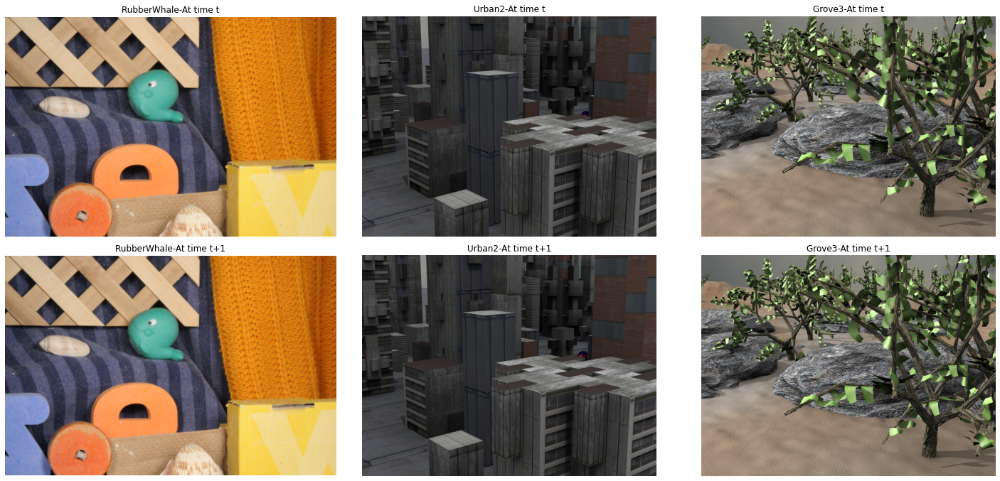

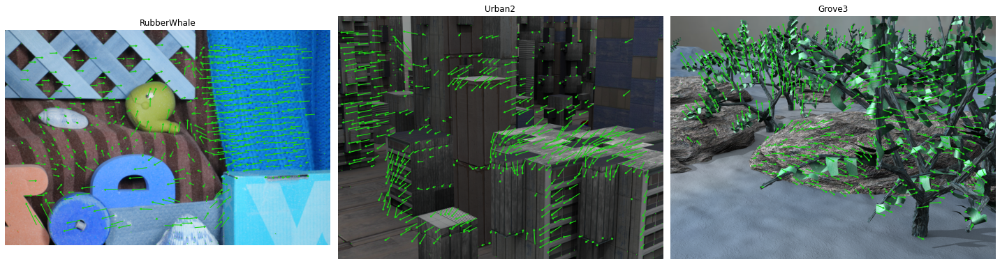

In [142]:
init_img_lst = [pair_img_lst[i][0] for i in range(3)]
tit_lst = [k+"-At time t" for k in fold_lst]+[k+"-At time t+1" for k in fold_lst]
plotter(2, 3, init_img_lst+[pair_img_lst[i][1] for i in range(3)], tit_lst, mode='RGB', figsize = (20, 10), lim_enabled = False)
plot_flow_in_row(init_img_lst, [OF_lst[k][0] for k in range(3)], [OF_lst[k][1] for k in range(3)], features_LK_lst, fold_lst)

### Analysis

__Change Window Size and Tau to see the effects...__

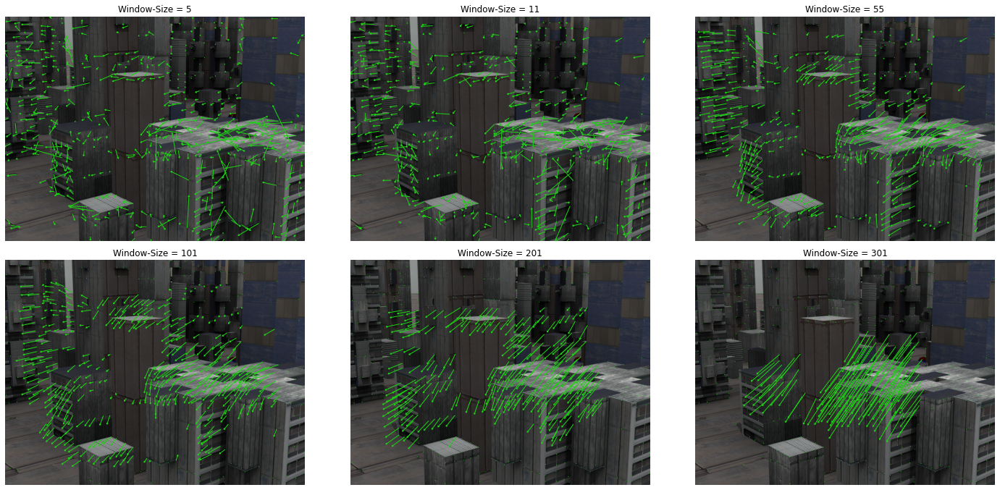

In [192]:
# Changing window size...
window_size_lst = [5, 11, 55, 101, 201, 301]
window_changed_OFs = [LukasKanadeForwardAdditive(pair_img_lst_gray[1][0], pair_img_lst_gray[1][1], features_LK_lst[1], k) for k in window_size_lst]
init_img_lst = [pair_img_lst[i][0] for i in range(3)]
tit_lst = [f"Window-Size = {k}" for k in window_size_lst]
plot_flow_in_rowandcol([pair_img_lst[1][0] for _ in window_size_lst], [window_changed_OFs[k][0] for k in range(len(window_size_lst))], [window_changed_OFs[k][1] for k in range(len(window_size_lst))], [features_LK_lst[1] for _ in window_size_lst], tit_lst)

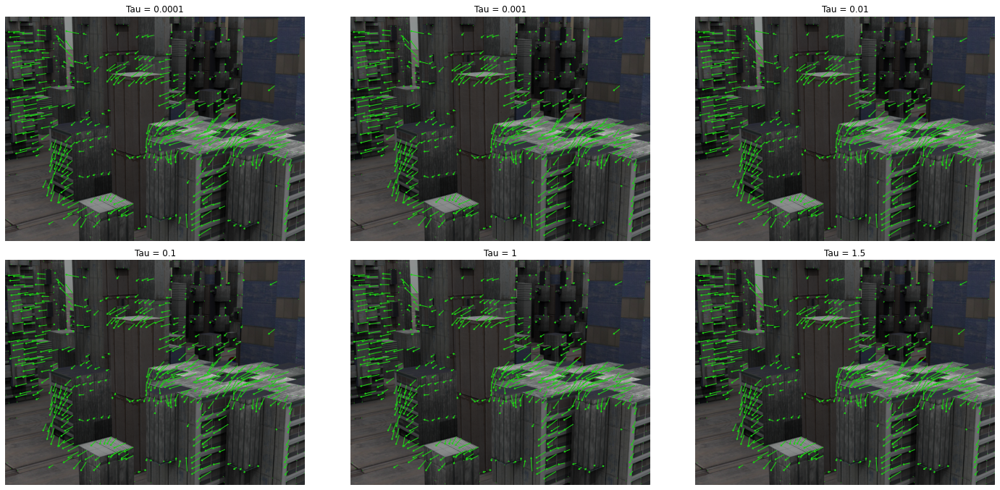

In [198]:
# Changing Tau...
tau_lst = [0.0001, 0.001, 0.01, 0.1, 1, 1.5]
tau_changed_OFs = [LukasKanadeForwardAdditive(pair_img_lst_gray[1][0], pair_img_lst_gray[1][1], features_LK_lst[1], 55, tau=k) for k in tau_lst]
init_img_lst = [pair_img_lst[i][0] for i in range(3)]
tit_lst = [f"Tau = {k}" for k in tau_lst]
plot_flow_in_rowandcol([pair_img_lst[1][0] for _ in tau_lst], [tau_changed_OFs[k][0] for k in range(len(tau_lst))], [tau_changed_OFs[k][1] for k in range(len(tau_lst))], [features_LK_lst[1] for _ in tau_lst], tit_lst)

# Multi-Scale Coarse-to-fine Optical Flow

Modify your algorithm to iteratively refine the optical flow estimate from multiple image resolutions. The basic idea is to initially compute the optical flow at a coarse image resolution. The obtained optical flow can then be upsampled and refined at successively higher resolutions, up to the resolution of the original input images. By computing the optical flow in this manner, we can circumvent the aperture problem to some degree – because the window size remains fixed across all resolutions, the algorithm effectively computes the optical flow using successively smaller apertures. This approach also works well on images with large displacements, something the single-scale algorithm is unable to handle.

In terms of implementation, first modify your code from part two so that it accepts and refines parameters $u_0$ and $v_0$, which corresponds to the initial estimates of the optical flow.<br>
`OpticalFlowRefine(Img1, Img2, windowSize, u0, v0)`

Once `OpticalFlowRefine` is working, you should write another function,<br>
`MultiScaleLucasKanade(Img1, Img2, windowSize, numLevels)`

In [143]:
def get_AtA_inv_At(Iwx, Iwy):
    # Construct A matrix by stacking Iwx and Iwy side by side.
    A = np.hstack((Iwx, Iwy)); AtA = np.dot(A.T, A)
    if np.min(np.linalg.eigvals(AtA)) < 0.01:
        return None
    # Precomputed part
    return np.dot(np.linalg.pinv(AtA), A.T)

def OpticalFlowRefine(Img1, Img2, features, windowSize, u0, v0, smooth=True, max_iter=100, thresh = 1e-3):
    """
    (Ensure both images to be single channel)
    Input:
        Img1: Image taken at time = t (should be scaled and pre-processed)
        Img2: Image taken at time = t+1 (should be scaled and pre-processed)
        features: Interesting points in Img1 (whose co-ordinates should be in matrix format not x/y axis format)
        windowSize: size of window around each interest point
        u0: x-direction displacement
        v0: y-direction displacement
        thresh: 10^-3
    Output:
        Flow Vectors: u, v
    """
    u, v = u0.copy().astype(np.float32), v0.copy().astype(np.float32)
    # Warp the Img1 (now one level above in comparison to the previous level)
    if smooth:
        # Apply Gaussian Smoothing
        Img1 = cv2.GaussianBlur(Img1/255., (5, 5), (5-1)/6).clip(0, 1)
        Img2 = cv2.GaussianBlur(Img2/255., (5, 5), (5-1)/6).clip(0, 1)
    # Calculation of Sobelx
    Ix = cv2.Sobel(Img1, cv2.CV_64F, 1, 0, ksize=-1, scale=1, delta=0)
    # Calculation of Sobely
    Iy = cv2.Sobel(Img1, cv2.CV_64F, 0, 1, ksize=-1, scale=1, delta=0)
    # define window size
    w = windowSize//2
    # Discard those interest points, around which window of defined window-size can't be constructed
    for f in features:
        x_1, y_1 = f.ravel()
        # Discard those interest points, around which defined window-size can't be constructed
        if boundary_check(x_1, y_1, w, Img1.shape):
            continue
        # Take nxn window around interest point
        Iwx = Ix[x_1-w:x_1+w+1, y_1-w:y_1+w+1].flatten().reshape(-1, 1)
        Iwy = Iy[x_1-w:x_1+w+1, y_1-w:y_1+w+1].flatten().reshape(-1, 1)
        pre_A = get_AtA_inv_At(Iwx, Iwy)
        if pre_A is None:
            continue
        # Construct b vector from It
        prev_b = Img1[x_1-w:x_1+w+1, y_1-w:y_1+w+1]
        for k in range(max_iter):
            # Initialize vars and update co-ordinates for window running on Image2
            x_2, y_2 = np.round(x_1 + u[x_1, y_1]).astype("int"), np.round(y_1 + v[x_1, y_1]).astype("int")
            # Discard those interest points, around which defined window-size can't be constructed
            if boundary_check(x_2, y_2, w, Img1.shape):
                break
            # ------------------------ Recalculate b
            b = (Img2[x_2-w:x_2+w+1, y_2-w:y_2+w+1] - prev_b).flatten().reshape(-1, 1)
            # Now compute the new updates du and dv.
            du, dv = -1*np.dot(pre_A, b).ravel()
            # Say if u and v at respective coordinates are very small then without matching
            # the patch on image 2 with patch on Img1 we'll be terminating the loop
            if np.abs(du) + np.abs(dv) < thresh:
                # print("hit")
                break
            # Update the u and v...
            u[x_1, y_1] += du
            v[x_1, y_1] += dv
    return u, v

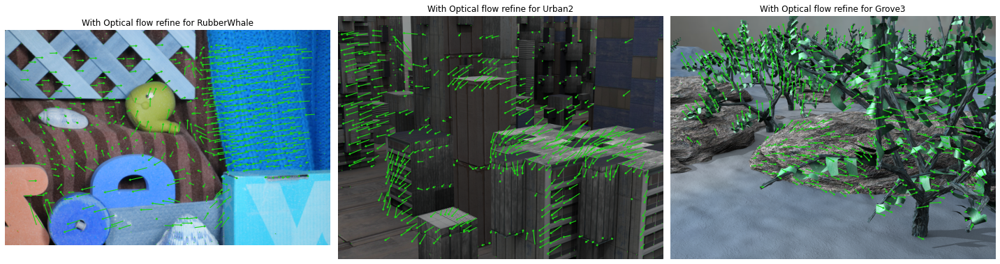

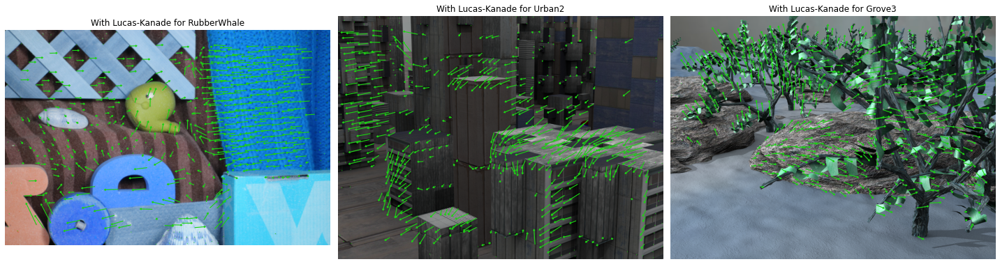

In [204]:
OFR_lst = [OpticalFlowRefine(pair_img_lst_gray[i][0], pair_img_lst_gray[i][1], features_LK_lst[i], 55, u0=np.zeros_like(pair_img_lst_gray[i][0]), v0=np.zeros_like(pair_img_lst_gray[i][0]), smooth=True, max_iter=15) for i in range(3)]

tit1_lst = ["With Optical flow refine for "+k for k in fold_lst]
plot_flow_in_row(init_img_lst, [OFR_lst[k][0] for k in range(3)], [OFR_lst[k][1] for k in range(3)], features_LK_lst, tit1_lst)
tit2_lst = ["With Lucas-Kanade for "+k for k in fold_lst]
plot_flow_in_row(init_img_lst, [OF_lst[k][0] for k in range(3)], [OF_lst[k][1] for k in range(3)], features_LK_lst, tit2_lst)

In [144]:
features_LKR = np.fliplr(cv2.goodFeaturesToTrack(pair_img_lst_gray[1][0], 600, 0.01, 10).reshape(-1,2).astype(np.int32))

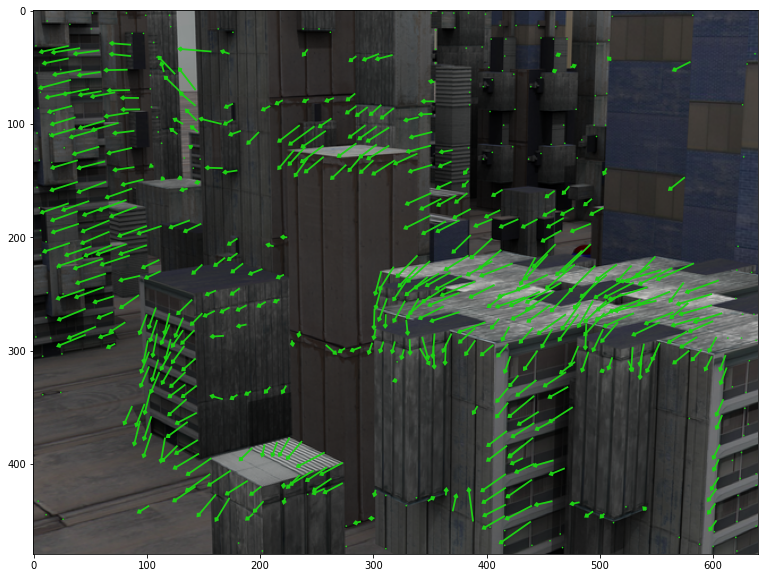

In [159]:
u_it, v_it = OpticalFlowRefine(pair_img_lst_gray[1][0], pair_img_lst_gray[1][1], features_LKR, 55, np.zeros_like(pair_img_lst_gray[1][0]), np.zeros_like(pair_img_lst_gray[1][0]), max_iter=15, thresh = 1e-2)
_ = plot_flow(pair_img_lst[1][0], u_it, v_it, features=features_LKR)#np.fliplr()

__Optical flow (Multi-Scale Lucas-Kanade)__

1. Step 01. Gaussian smooth and scale `Img1` and `Img2` by a factor of $2ˆ{(1 - numLevels)}$.
2. Step 02. Compute the optical flow at this resolution.
3. Step 03. For each level,
    1. Scale `Img1` and `Img2` by a factor of $2^{(1 - level)}$
    2. Upscale the previous layer‘s optical flow by a factor of $2$
    3. Compute $u$ and $v$ by calling `OpticalFlowRefine` with the previous level‘s optical flow

In [8]:
def MultiScaleLucasKanade(Img1, Img2, points, windowSize, numLevels):
    """"""
    # get the shape of Images.
    m, n = Img1.shape
    # Now iterate over levels and blur the images.
    for level in range(numLevels, 0, -1):
        # Size at nth level...
        m_small, n_small = m//(2**(level-1)), n//(2**(level-1)) 
        # scale both images...with x-scaling first and then y-scaling second...
        img1_lev = cv2.resize(Img1, (n_small, m_small))
        img2_lev = cv2.resize(Img2, (n_small, m_small))
        # Calculate Optical flow between Img1 and Img2 at lowest resolution.
        if level == numLevels:
            pts = points.copy()//(2**(level-1))
            # Initialize the displacement vectors to zeros
            u0 = v0 = np.zeros_like(img1_lev)
            # Obtain the estimated displacement
            u0, v0 = LukasKanadeForwardAdditive(img1_lev, img2_lev, pts, windowSize//2**(level-1))
            # u0, v0 = OpticalFlowRefine(img1_lev, img2_lev, pts, windowSize//2**(level-1), u0, v0, smooth=False, max_iter=1)
        else:# Optical flow at other resolution
            # Get the Scaled feature points
            pts = points.copy()//(2**(level-1))
            # Resize the optical flow matrix (i.e., both the x-matrix and y-matrix)
            u0, v0 = cv2.resize(u0, None, fx=2, fy=2, interpolation=cv2.INTER_CUBIC), cv2.resize(v0, None, fx=2, fy=2, interpolation=cv2.INTER_CUBIC)        
            # Compute the residual flows
            du, dv = LukasKanadeForwardAdditive(img1_lev, img2_lev, pts, windowSize//2**(level-1), u_and_v=(u0, v0))
            # du, dv = OpticalFlowRefine(img1_lev, img2_lev, pts, windowSize//2**(level-1), u0, v0, smooth=True, max_iter=1)
            # add residual optical flow
            u0, v0 = u0 + du, v0 + dv
    # assert shape of both u0 and v0 with img1 shape.
    if u0.shape != Img1.shape or v0.shape != Img1.shape:
        # pad zeros...
        m1, n1 = u0.shape
        u_temp = np.ones_like(Img1)*0.1
        v_temp = np.ones_like(Img1)*0.1
        for i in range(m1):
            for j in range(n1):
                u_temp[i, j] = u0[i, j]
                v_temp[i, j] = v0[i, j]
        return u_temp, v_temp
    return u0, v0

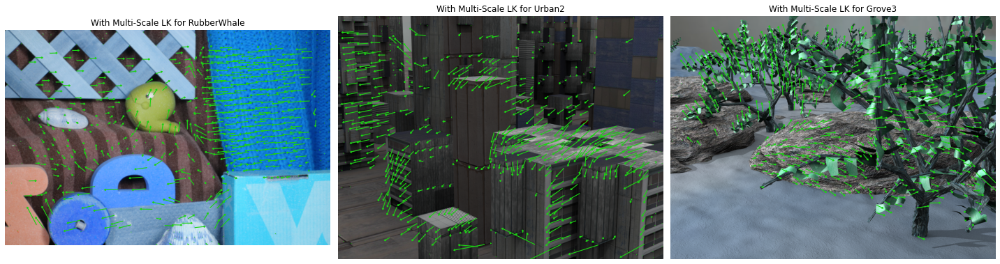

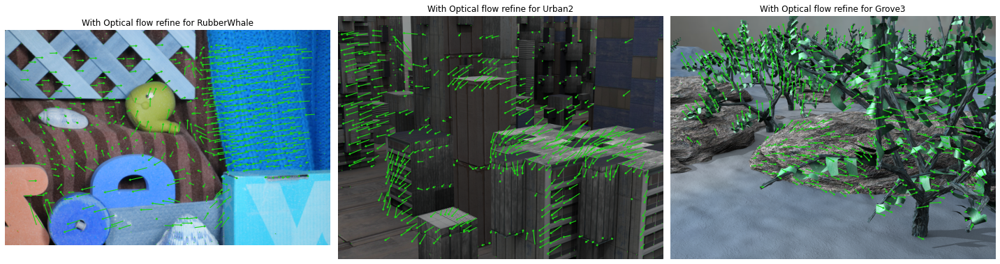

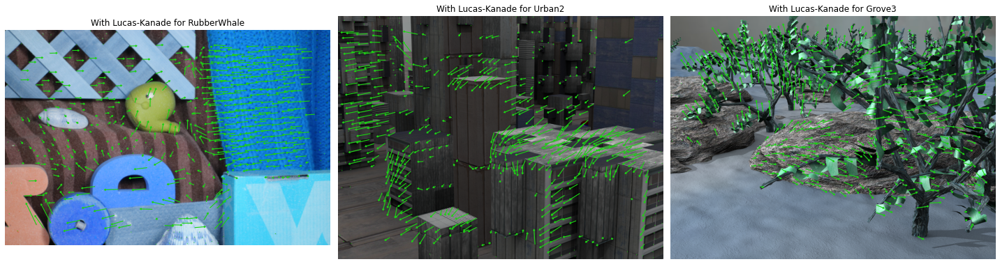

In [276]:
MOFR_lst = [MultiScaleLucasKanade(pair_img_lst_gray[i][0], pair_img_lst_gray[i][1], features_LK_lst[i], 60, 4) for i in range(3)]

tit3_lst = ["With Multi-Scale LK for "+k for k in fold_lst]
# mn_lst = [(k[0].shape[0], k[0].shape[1]) for k in MOFR_lst]
# init_img_lst_redefined = [init_img_lst[k][:m, :n, :] for k, (m, n) in zip(range(3), mn_lst)]
plot_flow_in_row(init_img_lst, [MOFR_lst[k][0] for k in range(3)], [MOFR_lst[k][1] for k in range(3)], features_LK_lst, tit3_lst)
plot_flow_in_row(init_img_lst, [OFR_lst[k][0] for k in range(3)], [OFR_lst[k][1] for k in range(3)], features_LK_lst, tit1_lst)
plot_flow_in_row(init_img_lst, [OF_lst[k][0] for k in range(3)], [OF_lst[k][1] for k in range(3)], features_LK_lst, tit2_lst)

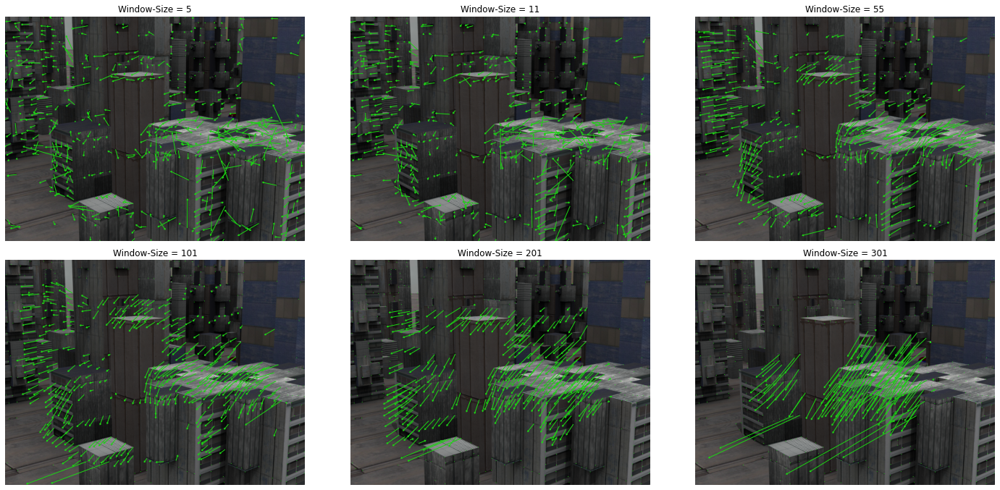

In [269]:
# Changing window size...
window_size_lst = [5, 11, 55, 101, 201, 301]
window_changed_OFs = [MultiScaleLucasKanade(pair_img_lst_gray[1][0], pair_img_lst_gray[1][1], features_LK_lst[1], k, 4) for k in window_size_lst]
tit4_lst = [f"Window-Size = {k}" for k in window_size_lst]
plot_flow_in_rowandcol([pair_img_lst[1][0] for _ in window_size_lst], [window_changed_OFs[k][0] for k in range(len(window_size_lst))], [window_changed_OFs[k][1] for k in range(len(window_size_lst))], [features_LK_lst[1] for _ in window_size_lst], tit4_lst)

In [ ]:
img1_tc = cv2.imread("../data/all-frames-colour/RubberWhale/frame07.png")
img2_tc = cv2.imread("../data/all-frames-colour/RubberWhale/frame08.png")
img3_tc = cv2.imread("../data/all-frames-colour/RubberWhale/frame09.png")
img4_tc = cv2.imread("../data/all-frames-colour/RubberWhale/frame10.png")
img5_tc = cv2.imread("../data/all-frames-colour/RubberWhale/frame11.png")
img6_tc = cv2.imread("../data/all-frames-colour/RubberWhale/frame12.png")
img7_tc = cv2.imread("../data/all-frames-colour/RubberWhale/frame13.png")
img8_tc = cv2.imread("../data/all-frames-colour/RubberWhale/frame14.png")

img1_t = cv2.cvtColor(img1_tc, cv2.COLOR_BGR2GRAY)
img2_t = cv2.cvtColor(img2_tc, cv2.COLOR_BGR2GRAY)
img3_t = cv2.cvtColor(img3_tc, cv2.COLOR_BGR2GRAY)
img4_t = cv2.cvtColor(img4_tc, cv2.COLOR_BGR2GRAY)
img5_t = cv2.cvtColor(img5_tc, cv2.COLOR_BGR2GRAY)
img6_t = cv2.cvtColor(img6_tc, cv2.COLOR_BGR2GRAY)
img7_t = cv2.cvtColor(img7_tc, cv2.COLOR_BGR2GRAY)
img8_t = cv2.cvtColor(img8_tc, cv2.COLOR_BGR2GRAY)

imgss_gray = [img1_t, img1_t, img2_t, img3_t, img4_t, img5_t, img6_t, img7_t, img8_t]
imgss = [img1_tc, img1_tc, img2_tc, img3_tc, img4_tc, img5_tc, img6_tc, img7_tc, img8_tc]
features_LK_lst = [np.fliplr(cv2.goodFeaturesToTrack(
    imgk, 600, 0.01, 10).astype(np.int32).reshape(-1, 2)) for imgk in imgss_gray[:-1]]
OFSS = [MultiScaleLucasKanade(
    imgss_gray[i], imgss_gray[i+1], features_LK_lst[i], 55, 4) for i in range(7)]
for i in range(7):
    _ = plot_flow(imgss[i], OFSS[i][0], OFSS[i][1], features_LK_lst[i],
                  save=True, name=f"../data/all-frames-colour/RubberWhale/OFframe{i+1}.png")

__Generate video from images...__

In [20]:
# Generate video:
img2vid(img_folder_path="../data/all-frames-colour/dhruv/urban2/", generated_vid_path="../data/all-frames-colour/dhruv/urban2/Urban2.mp4", fps=1)
img2vid(img_folder_path="../data/all-frames-colour/dhruv/grove3/", generated_vid_path="../data/all-frames-colour/dhruv/grove3/Grove3.mp4", fps=1)
img2vid(img_folder_path="../data/all-frames-colour/dhruv/rubberWhale/", generated_vid_path="../data/all-frames-colour/dhruv/rubberWhale/RubberWhale.mp4", fps=1)

OpenCV: FFMPEG: tag 0x47504a4d/'MJPG' is not supported with codec id 7 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'
OpenCV: FFMPEG: tag 0x47504a4d/'MJPG' is not supported with codec id 7 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'
OpenCV: FFMPEG: tag 0x47504a4d/'MJPG' is not supported with codec id 7 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'


In [ ]:
# 1)---------------------------- Feature Detection
# Sparse tracking ---> Requires Good features to track
features_LK_lst = [np.fliplr(cv2.goodFeaturesToTrack(pair_img_lst_gray[i][0], 600, 0.01, 10).astype(np.int32).reshape(-1, 2)) for i in range(3)]

In [134]:
OF_lst = [LukasKanadeForwardAdditive(pair_img_lst_gray[i][0], pair_img_lst_gray[i][1], features_LK_lst[i], 55) for i in range(3)]
# _ = plot_flow(im1, u, v, dense=False, features=features_LK)#np.fliplr()

In [ ]:
init_img_lst = [pair_img_lst[i][0] for i in range(3)]
tit_lst = [k+"-At time t" for k in fold_lst]+[k+"-At time t+1" for k in fold_lst]
plotter(2, 3, init_img_lst+[pair_img_lst[i][1] for i in range(3)], tit_lst, mode='RGB', figsize = (20, 10), lim_enabled = False)
plot_flow_in_row(init_img_lst, [OF_lst[k][0] for k in range(3)], [OF_lst[k][1] for k in range(3)], features_LK_lst, fold_lst)

# ROUGH

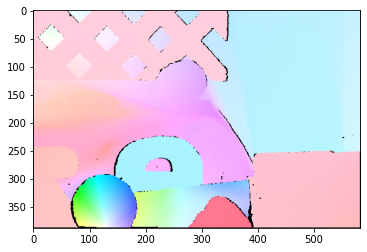

In [667]:
show_flow("../data/ground-truth-flow/RubberWhale/flow10.flo")

In [257]:
UNKNOWN_FLOW_THRESH = 1e7
def show_flow(filename):
    """
    visualize optical flow map using matplotlib
    :param filename: optical flow file
    :return: None
    """
    flow = read_flow(filename)
    img = flow_to_image(flow)
    plt.imshow(img)
    plt.show()

def read_flow(filename):
    """
    read optical flow from Middlebury .flo file
    :param filename: name of the flow file
    :return: optical flow data in matrix
    """
    f = open(filename, 'rb')
    magic = np.fromfile(f, np.float32, count=1)
    data2d = None

    if 202021.25 != magic:
        print ('Magic number incorrect. Invalid .flo file')
    else:
        w = int(np.fromfile(f, np.int32, count=1)[0])
        h = int(np.fromfile(f, np.int32, count=1)[0])
        #print("Reading %d x %d flo file" % (h, w))
        data2d = np.fromfile(f, np.float32, count=2 * w * h)
        # reshape data into 3D array (columns, rows, channels)
        data2d = np.resize(data2d, (h, w, 2))
    f.close()
    return data2d

def flow_to_image(flow):
    """
    Convert flow into middlebury color code image
    :param flow: optical flow map
    :return: optical flow image in middlebury color
    """
    u = flow[:, :, 0]
    v = flow[:, :, 1]

    maxu = -999.
    maxv = -999.
    minu = 999.
    minv = 999.

    idxUnknow = (abs(u) > UNKNOWN_FLOW_THRESH) | (abs(v) > UNKNOWN_FLOW_THRESH)
    u[idxUnknow] = 0
    v[idxUnknow] = 0

    maxu = max(maxu, np.max(u))
    minu = min(minu, np.min(u))

    maxv = max(maxv, np.max(v))
    minv = min(minv, np.min(v))

    rad = np.sqrt(u ** 2 + v ** 2)
    maxrad = max(-1, np.max(rad))

    u = u/(maxrad + np.finfo(float).eps)
    v = v/(maxrad + np.finfo(float).eps)

    img = compute_color(u, v)

    idx = np.repeat(idxUnknow[:, :, np.newaxis], 3, axis=2)
    img[idx] = 0

    return np.uint8(img)


def compute_color(u, v):
    """
    compute optical flow color map
    :param u: optical flow horizontal map
    :param v: optical flow vertical map
    :return: optical flow in color code
    """
    [h, w] = u.shape
    img = np.zeros([h, w, 3])
    nanIdx = np.isnan(u) | np.isnan(v)
    u[nanIdx] = 0
    v[nanIdx] = 0

    colorwheel = make_color_wheel()
    ncols = np.size(colorwheel, 0)

    rad = np.sqrt(u**2+v**2)

    a = np.arctan2(-v, -u) / np.pi

    fk = (a+1) / 2 * (ncols - 1) + 1

    k0 = np.floor(fk).astype(int)

    k1 = k0 + 1
    k1[k1 == ncols+1] = 1
    f = fk - k0

    for i in range(0, np.size(colorwheel,1)):
        tmp = colorwheel[:, i]
        col0 = tmp[k0-1] / 255
        col1 = tmp[k1-1] / 255
        col = (1-f) * col0 + f * col1

        idx = rad <= 1
        col[idx] = 1-rad[idx]*(1-col[idx])
        notidx = np.logical_not(idx)

        col[notidx] *= 0.75
        img[:, :, i] = np.uint8(np.floor(255 * col*(1-nanIdx)))

    return img


def make_color_wheel():
    """
    Generate color wheel according Middlebury color code
    :return: Color wheel
    """
    RY = 15
    YG = 6
    GC = 4
    CB = 11
    BM = 13
    MR = 6

    ncols = RY + YG + GC + CB + BM + MR

    colorwheel = np.zeros([ncols, 3])

    col = 0

    # RY
    colorwheel[0:RY, 0] = 255
    colorwheel[0:RY, 1] = np.transpose(np.floor(255*np.arange(0, RY) / RY))
    col += RY

    # YG
    colorwheel[col:col+YG, 0] = 255 - np.transpose(np.floor(255*np.arange(0, YG) / YG))
    colorwheel[col:col+YG, 1] = 255
    col += YG

    # GC
    colorwheel[col:col+GC, 1] = 255
    colorwheel[col:col+GC, 2] = np.transpose(np.floor(255*np.arange(0, GC) / GC))
    col += GC

    # CB
    colorwheel[col:col+CB, 1] = 255 - np.transpose(np.floor(255*np.arange(0, CB) / CB))
    colorwheel[col:col+CB, 2] = 255
    col += CB

    # BM
    colorwheel[col:col+BM, 2] = 255
    colorwheel[col:col+BM, 0] = np.transpose(np.floor(255*np.arange(0, BM) / BM))
    col += + BM

    # MR
    colorwheel[col:col+MR, 2] = 255 - np.transpose(np.floor(255 * np.arange(0, MR) / MR))
    colorwheel[col:col+MR, 0] = 255

    return colorwheel

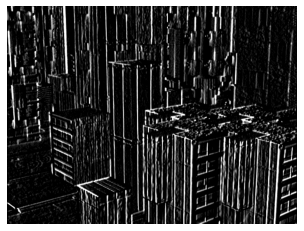

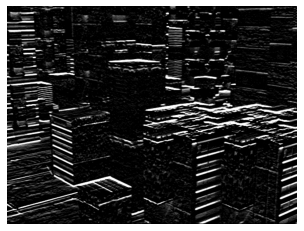

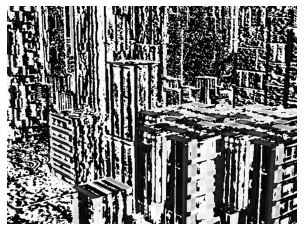

In [536]:
img1 = cv2.GaussianBlur(img1, (5, 5), (5-1)/6)
img2 = cv2.GaussianBlur(img2, (5, 5), (5-1)/6)
Ix = cv2.Sobel(img1, cv2.CV_64F,1,0,ksize=-1).astype(np.float64).clip(0, 225)

# Calculation of Sobely
Iy = cv2.Sobel(img1, cv2.CV_64F,0,1,ksize=-1).astype(np.float64).clip(0, 225)
# Implement Lucas Kanade : for each point, calculate I_x, I_y, I_t
# Ix = ndimage.convolve(Img1, kernel_x, mode='constant', cval=0.0)
# Iy = ndimage.convolve(Img1, kernel_y, mode='constant', cval=0.0)
It = img2 - img1

plt.imshow(Ix, cmap="gray"); plt.axis("off"); plt.show()
plt.imshow(Iy, cmap="gray"); plt.axis("off");plt.show()
plt.imshow(It, cmap="gray"); plt.axis('off'); plt.show()

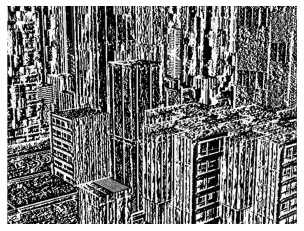

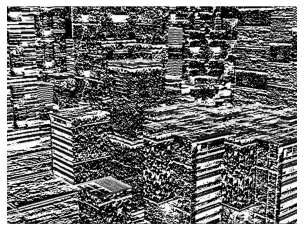

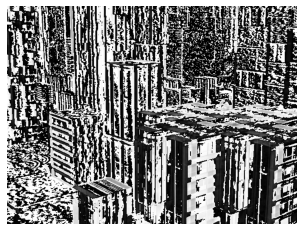

In [283]:
# Apply Gaussian Smoothing
Img1 = cv2.GaussianBlur(img1, (5, 5), (5-1)/6)
Img2 = cv2.GaussianBlur(img2, (5, 5), (5-1)/6)
# Ensure Image is normalized
# Img1 = Img1 / 255. # normalize pixels
# Img2 = Img2 / 255. # normalize pixels
# 2)--------------------------- Compute Ix and Iy
# Compute Ix and Iy, also It( which is b)
kernel_x = np.array([[-1., 0., 1.]])#, [-2., 0., 2.], [-1., 0., 1.]
kernel_y = np.array([[-1., 0., 1.]]).T#, [0., 0., 0.], [1., 2., 1.]
# kernel_t = np.array([[1., 1.], [1., 1.]])#*.25
# Implement Lucas Kanade : for each point, calculate I_x, I_y, I_t
Ix = ndimage.convolve(Img1, kernel_x, mode='constant', cval=0.0)
Iy = ndimage.convolve(Img1, kernel_y, mode='constant', cval=0.0)
It = Img2 - Img1
plt.imshow(Ix, cmap="gray"); plt.axis("off"); plt.show()
plt.imshow(Iy, cmap="gray"); plt.axis("off");plt.show()
plt.imshow(It, cmap="gray"); plt.axis('off'); plt.show()

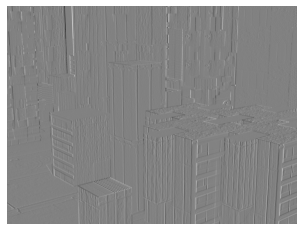

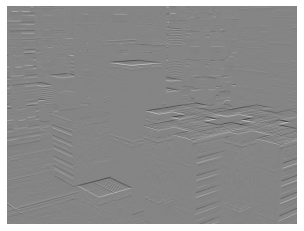

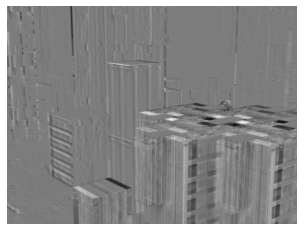

In [285]:
# Apply Gaussian Smoothing
# img1 = cv2.GaussianBlur(img1, (5, 5), (5-1)/6)
# img2 = cv2.GaussianBlur(img2, (5, 5), (5-1)/6)
kernel_x = np.array([[-1., 1.], [-1., 1.]])
kernel_y = np.array([[-1., -1.], [1., 1.]])
kernel_t = np.array([[1., 1.], [1., 1.]])
Ix = signal.convolve2d(img1, kernel_x, boundary='symm', mode="same")
Iy = signal.convolve2d(img1, kernel_y, boundary='symm', mode="same")
It = signal.convolve2d(img2, kernel_t, boundary='symm', mode="same") + signal.convolve2d(img1, -kernel_t, boundary='symm', mode="same")

plt.imshow(Ix, cmap="gray"); plt.axis("off"); plt.show()
plt.imshow(Iy, cmap="gray"); plt.axis("off");plt.show()
plt.imshow(It, cmap="gray"); plt.axis('off'); plt.show()

In [2]:
# calculate optical flow

def temp_flow(img1, img2, img_col):
    # params for ShiTomasi corner detection
    feature_params = dict( maxCorners = 400,
                           qualityLevel = 0.1,
                           minDistance = 7,
                           blockSize = 7 )

    # prevgray = cv2.cvtColor(img1_t, cv2.COLOR_BGR2GRAY)
    p0 = cv2.goodFeaturesToTrack(img1, mask = None, **feature_params)

    # Parameters for lucas kanade optical flow
    lk_params = dict( winSize  = (15,15),
                      maxLevel = 0,
                      criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))
    p1, st, err = cv2.calcOpticalFlowPyrLK(img1, img2,p0, None, **lk_params)
    
    mask = np.zeros_like(img1)
    for i,(new,old) in enumerate(zip(p1, p0)):
        a,b = new.ravel()
        c,d = old.ravel()
        a,b,c,d = int(a), int(b), int(c), int(d)
        mask = cv2.arrowedLine(img_col, (c,d), (a,b), (0,255,0), 2)
        # frame = cv2.circle(img2_t,(a,b),5, (0,0,255),-1)

    img = cv2.add(img_col, mask)

    plt.figure(figsize=(20,10))
    plt.imshow(img)
    plt.show()
    
    # return p1, st, err
    return mask

In [3]:
def img2vid_new(img_folder_path="../data/all-frames-colour/Urban2/", generated_vid_path="../data/all-frames-colour/Urban2/Urban2_new.mp4", fps=1):
    """
    Construct Video from Images.
    Inputs:
        img_folder_path: Path for Images.
        generated_vid_path: Path from which video is taken.
        fps: Frame Per Sec.
        e.g., fps=1 => 1 frame per sec, while fps=0.5 => 0.5 frames per sec => 1 frame per 2 sec
    """
    # Collect Image Names
    file_names = [os.path.join(img_folder_path, f) for f in os.listdir(img_folder_path) if os.path.isfile(os.path.join(img_folder_path, f))]
    # print(int(file_names[0].split(".png")[0][-2:]))
    file_names.sort(key = lambda x:int(x.split(".png")[0][-2:]), reverse=False)
    file_names = file_names + [file_names[0]]
    # print(file_names)
    # Read above Images and save them in a list.
    frame_arr = []
    for file in file_names:
        img = cv2.imread(file)
        frame_arr.append(img)
    img_shape = (img.shape[1], img.shape[0])# (width, height)
    # Create a Videowriter Object to concat the frames to generate video along time dimension.
    out = cv2.VideoWriter(generated_vid_path, cv2.VideoWriter_fourcc(*'MJPG'), fps, img_shape)
    #also *'DIVX' can be used
    
    for i in range(len(frame_arr)-1):
        # writing to a image array
        out.write(temp_flow(cv2.cvtColor(frame_arr[i], cv2.COLOR_BGR2GRAY), cv2.cvtColor(frame_arr[i+1], cv2.COLOR_BGR2GRAY), frame_arr[i]))
    out.release()

In [178]:
img2vid_new()

OpenCV: FFMPEG: tag 0x47504a4d/'MJPG' is not supported with codec id 7 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'


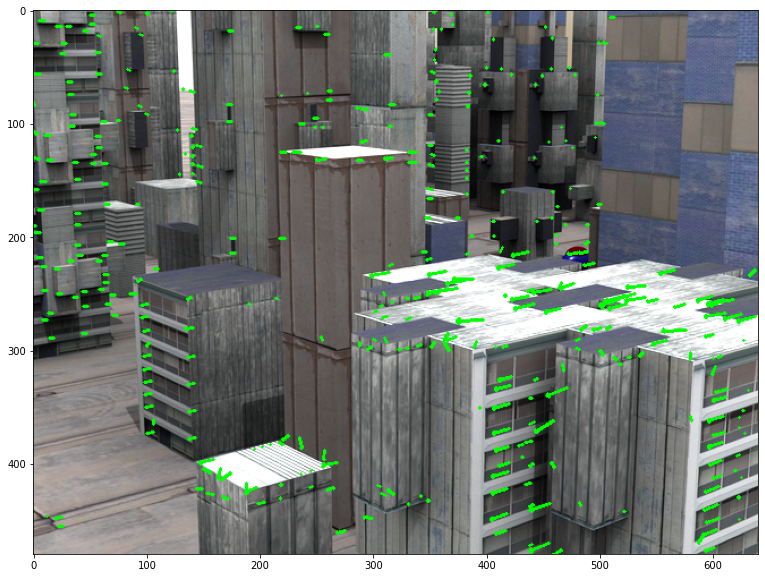

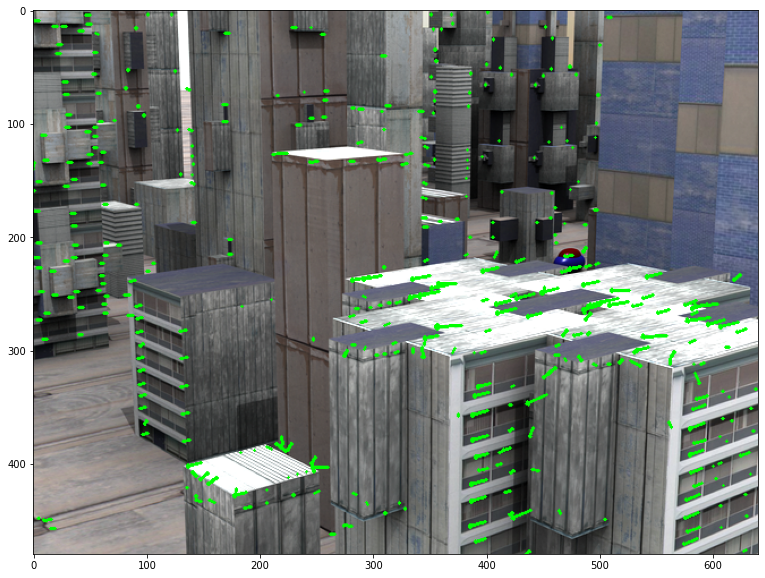

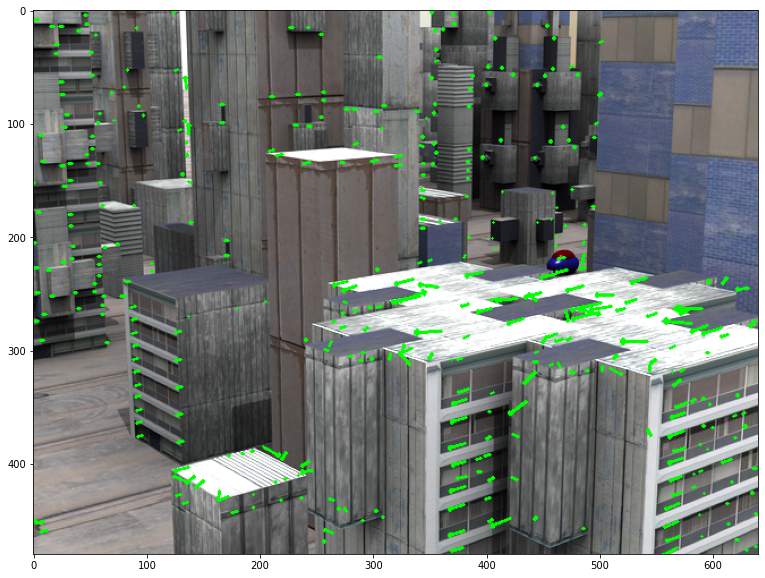

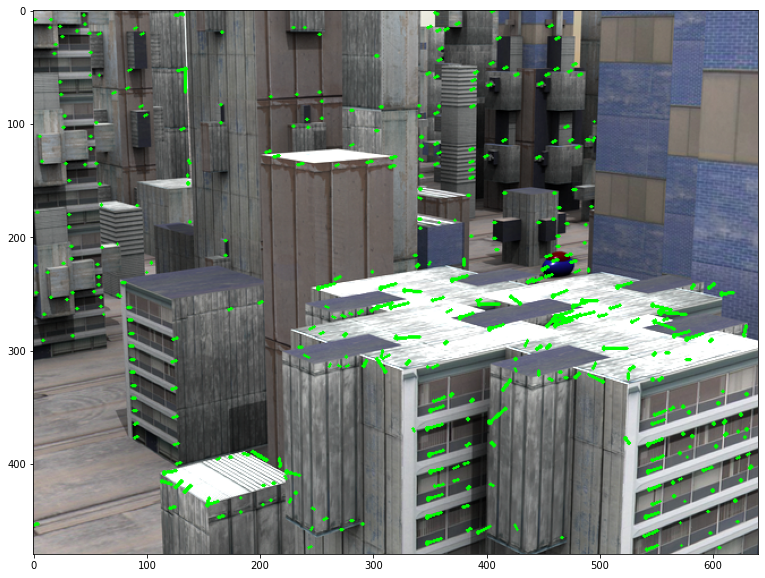

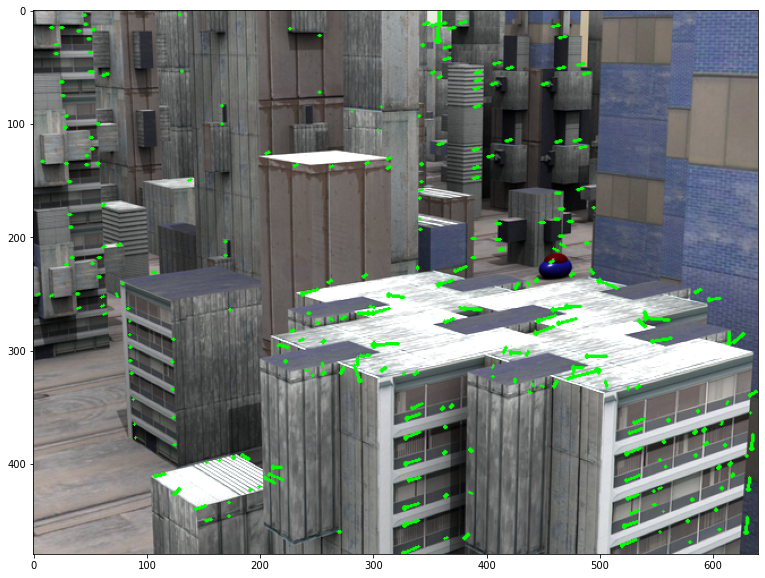

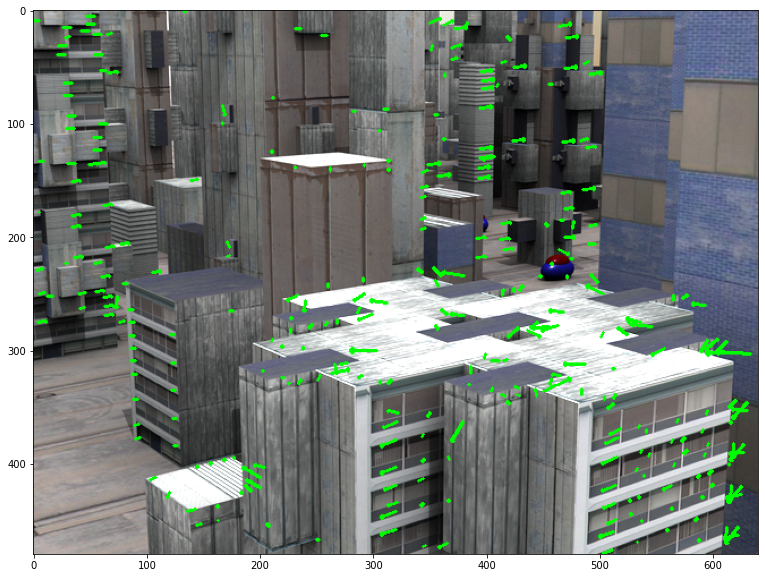

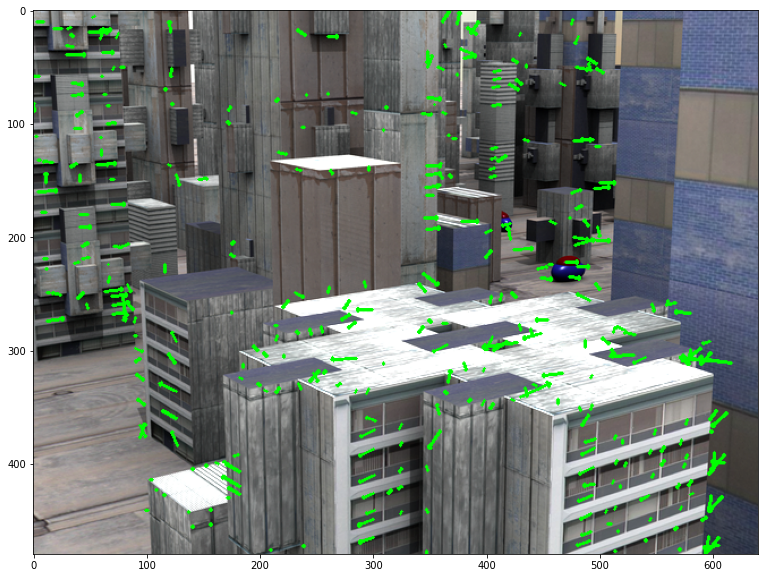

In [184]:
img1_tc = cv2.imread("../data/all-frames-colour/Urban2/frame07.png")
img2_tc = cv2.imread("../data/all-frames-colour/Urban2/frame08.png")
img3_tc = cv2.imread("../data/all-frames-colour/Urban2/frame09.png")
img4_tc = cv2.imread("../data/all-frames-colour/Urban2/frame10.png")
img5_tc = cv2.imread("../data/all-frames-colour/Urban2/frame11.png")
img6_tc = cv2.imread("../data/all-frames-colour/Urban2/frame12.png")
img7_tc = cv2.imread("../data/all-frames-colour/Urban2/frame13.png")
img8_tc = cv2.imread("../data/all-frames-colour/Urban2/frame14.png")

img1_t = cv2.cvtColor(img1_tc, cv2.COLOR_BGR2GRAY)
img2_t = cv2.cvtColor(img2_tc, cv2.COLOR_BGR2GRAY)
img3_t = cv2.cvtColor(img3_tc, cv2.COLOR_BGR2GRAY)
img4_t = cv2.cvtColor(img4_tc, cv2.COLOR_BGR2GRAY)
img5_t = cv2.cvtColor(img5_tc, cv2.COLOR_BGR2GRAY)
img6_t = cv2.cvtColor(img6_tc, cv2.COLOR_BGR2GRAY)
img7_t = cv2.cvtColor(img7_tc, cv2.COLOR_BGR2GRAY)
img8_t = cv2.cvtColor(img8_tc, cv2.COLOR_BGR2GRAY)

_ = temp_flow(img1_t, img2_t, img2_tc)
_ = temp_flow(img2_t, img3_t, img3_tc)
_ = temp_flow(img3_t, img4_t, img4_tc)
_ = temp_flow(img4_t, img5_t, img5_tc)
_ = temp_flow(img5_t, img6_t, img6_tc)
_ = temp_flow(img6_t, img7_t, img7_tc)
_ = temp_flow(img7_t, img8_t, img8_tc)


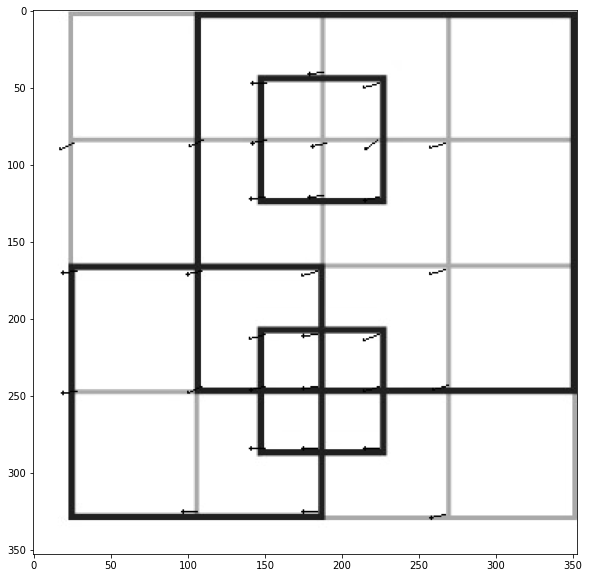

In [ ]:
u, v = LukasKanadeForwardAdditive(img1, img2, 50, 0.01)
img = addQuivers(u, v, img1)
# plt.figure(figsize=(20, 10))
# plt.imshow(img, cmap="gray")
# plt.show()
plt.figure(figsize=(20, 10))
plt.imshow(img, cmap="gray")
plt.show()

In [622]:
# kernel_x = np.array([[-1., 1.], [-1., 1.]])
# kernel_y = np.array([[-1., -1.], [1., 1.]])
# kernel_t = np.array([[1., 1.], [1., 1.]])*0.25
# mode="same"
# Ix = signal.convolve2d(Img1, kernel_x, boundary='symm', mode=mode)
# Iy = signal.convolve2d(Img1, kernel_y, boundary='symm', mode=mode)
# It = signal.convolve2d(Img2, kernel_t, boundary='symm', mode=mode) + signal.convolve2d(Img1, -kernel_t, boundary='symm', mode=mode)

In [ ]:
# im = img1.copy()
# for k, f in enumerate(features):
#     x,y = f.ravel()
#     if k < 10:
#         print(f"x = {x} and y = {y}")
#         cv2.circle(im, (x, y), 4, (255, 0, 0), -1)
#         if y==17:
#             cv2.circle(im, (x, y), 7, (255, 0, 0), -1)
# plt.imshow(im, cmap="gray")
# plt.imshow(im[400:500, 100:200], cmap="gray")

In [305]:
class lucas_kanade(object):
    def __init__(self, IMG_PATH, IMG1_NAME, IMG2_NAME, resize_dim=None):
        self.img1 = cv2.imread(IMG_PATH + IMG1_NAME)
        self.img2 = cv2.imread(IMG_PATH + IMG2_NAME)
        if resize_dim:
            self.img1 = cv2.resize(self.img1, resize_dim, interpolation=cv2.INTER_AREA)
            self.img2 = cv2.resize(self.img2, resize_dim, interpolation=cv2.INTER_AREA)
        self.img1_gray = cv2.cvtColor(self.img1, cv2.COLOR_BGR2GRAY)
        self.img2_gray = cv2.cvtColor(self.img2, cv2.COLOR_BGR2GRAY)
        self.img1_gray_norm = self.img1_gray/255.0
        self.img2_gray_norm = self.img2_gray/255.0
        # feat_obj = corner_detector(IMG_PATH, IMG1_NAME)
        print(self.img1.shape)
        self.features =  (cv2.goodFeaturesToTrack(self.img1_gray, 500, 0.01, 10).astype(np.int32).reshape(-1, 2))#feat_obj.harris_corner_detector(plot=False)
        self.optical_flow = list()
        self.Ix = cv2.Sobel(self.img1_gray_norm, cv2.CV_64F, 1, 0, ksize=3, scale=1, delta=0)
        self.Iy = cv2.Sobel(self.img2_gray_norm, cv2.CV_64F, 0, 1, ksize=3, scale=1, delta=0)
        self.Ixx = self.Ix**2
        self.Ixy = self.Ix*self.Iy
        self.Iyy = self.Iy**2
        self.It = self.img1_gray_norm - self.img2_gray_norm

    def get_uv(self, img1_target, img2_target, window):
        im1_win = [[max(0, img1_target[1]-window), img1_target[1]+window],
                   [max(0, img1_target[0]-window), img1_target[0]+window]]
        im2_win = [[max(0, img2_target[1]-window), img2_target[1]+window],
                   [max(0, img2_target[0]-window), img2_target[0]+window]]
        Ix_win = self.Ix[im1_win[0][0]:im1_win[0][1], im1_win[1][0]:im1_win[1][1]].ravel()
        Iy_win = self.Iy[im1_win[0][0]:im1_win[0][1], im1_win[1][0]:im1_win[1][1]].ravel()
        Ixx_win = self.Ixx[im1_win[0][0]:im1_win[0][1], im1_win[1][0]:im1_win[1][1]].ravel()
        Ixy_win = self.Ixy[im1_win[0][0]:im1_win[0][1], im1_win[1][0]:im1_win[1][1]].ravel()
        Iyy_win = self.Iyy[im1_win[0][0]:im1_win[0][1], im1_win[1][0]:im1_win[1][1]].ravel()
        I1_win = self.img1_gray_norm[im1_win[0][0]:im1_win[0][1], im1_win[1][0]:im1_win[1][1]]
        I2_win = self.img2_gray_norm[im2_win[0][0]:im2_win[0][1], im2_win[1][0]:im2_win[1][1]]
        
        if tuple(I1_win.shape) != tuple(I2_win.shape):
            return (0, 0)
        It_win = (I1_win - I2_win).ravel()

        It_x_win = Ix_win * It_win
        It_y_win = Iy_win * It_win

        At_A = np.array([[Ixx_win.sum(), Ixy_win.sum()], [Ixy_win.sum(), Iyy_win.sum()]])
        At_d = np.array([It_x_win.sum(), It_y_win.sum()]).T

        uv = np.dot(np.linalg.pinv(At_A), At_d)
        u, v = uv[0], uv[1]
        return (u, v)

    def calculate_flow_once(self, window_size=25):
        total_featurs = len(self.features)
        self.optical_flow = list()
        for feat in self.features:
            img1_feat_pt = feat
            img2_feat_pt = feat
            u, v = self.get_uv(img1_feat_pt, img2_feat_pt, window_size)
            self.optical_flow.append((u, v))

    def iterative_solver(self, window_size=25, u_init=0, v_init=0, thresh=0.001, max_iter=100):
        self.optical_flow = list()
        for i, feat in enumerate(self.features):
            prev_u, prev_v = u_init, v_init
            target = [feat[0], feat[1]]
            for i in range(max_iter):
                u, v = self.get_uv(feat, target, window_size)
                if abs(u) + abs(v) < thresh:
                    break
                prev_u += u
                prev_v += v
                target[0] = feat[0] + int(prev_u)
                target[1] = feat[1] + int(prev_v)
            self.optical_flow.append((prev_u, prev_v))

    def plot_flow(self, name="", savefig=False):
        plot_img = cv2.cvtColor(self.img1, cv2.COLOR_BGR2RGB)
        x = [i[0] for i in self.features]
        y = [i[1] for i in self.features]
        u = [i[0] for i in self.optical_flow]
        v = [-i[1] for i in self.optical_flow]
        plt.figure(figsize=(20,10))
        plt.imshow(plot_img)
        plt.quiver(x, y, u, v, color="#1ed115", headlength=2, headaxislength=3)
        if savefig:
            plt.savefig(name)
        else:
            plt.show()

In [ ]:
def get_sample_points(img1, interval=3):
    """
    Based on size of Image1, returns semi-dense points (meaning sample points from Image.)
    """
    m, n = img1.shape if img1.ndim==2 else img1.shape[:2]
    # no. of pts to be selected along x and y axis
    x_pts = np.arange(interval, m-interval, interval)
    y_pts = np.arange(interval, n-interval, interval)
    # return n_pts_x*n_pts_y no. of points
    y, x = np.meshgrid(y_pts, x_pts)
    return np.array([[i, j] for i, j in zip(x.flatten(), y.flatten())])
    
def addQuivers(flow_vecs_x, flow_vecs_y, Img1):
    """
    Return image with quivers on it (which denotes the motion vectors)
    """
    img = Img1.copy()
    # Extract relevant positions
    threshed_pos = np.argwhere(((flow_vecs_x != 0) + (flow_vecs_y != 0))==True)
    # Now draw arrows on given image using these positions
    for pos in threshed_pos:
        # NOrmalize the displacement vector i.e, making unit vector
        # print(flow_vecs_x[pos[0], pos[1]]);print(flow_vecs_y[pos[0], pos[1]])
        u = 300*flow_vecs_x[pos[0], pos[1]]#/np.sqrt((flow_vecs_x[pos[0], pos[1]])**2 + (flow_vecs_y[pos[0], pos[1]])**2)
        v = 300*flow_vecs_y[pos[0], pos[1]]#/np.sqrt((flow_vecs_x[pos[0], pos[1]])**2 + (flow_vecs_y[pos[0], pos[1]])**2)
        img = cv2.arrowedLine(img, (pos[1], pos[0]), (np.int32(pos[1]+u), np.int32(pos[0]+v)), (0, 0, 255), 1)# Thickness = 1, color = (255, 0, 0) = red
    return img



In [ ]:
init_img_lst = [pair_img_lst[i][0] for i in range(3)]
tit_lst = [k+"-At time \"t\"" for k in fold_lst]+[k-"At time \"t+1\"" for k in fold_lst]
plotter(2, 3, init_img_lst+[pair_img_lst[i][1] for i in range(3)], tit_lst, mode='RGB', figsize = (20, 20), lim_enabled = False)
plot_flow_in_row(init_img_lst, [OF_lst[k][0] for k in range(3)], [OF_lst[k][1] for k in range(3)], features_LK_lst, fold_lst)

(480, 640, 3)


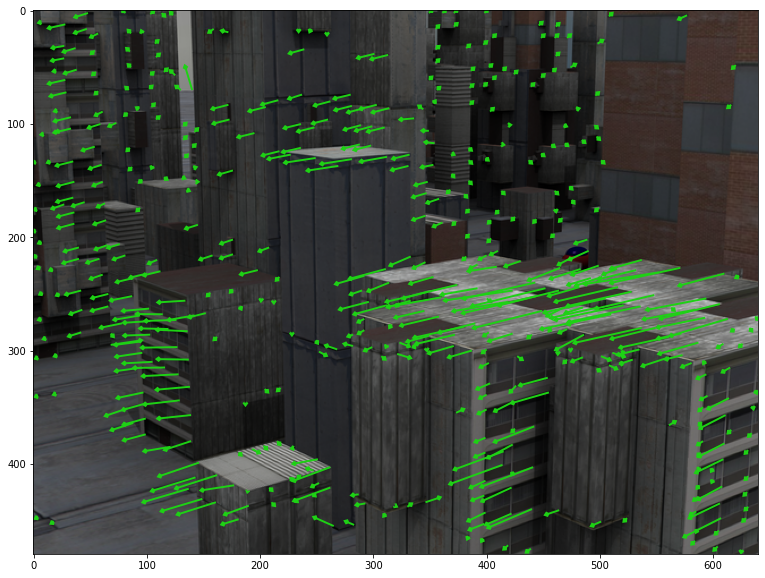

In [308]:
lk_test = lucas_kanade("../data/all-frames-colour/Urban2/", "frame08.png", "frame09.png")
lk_test.iterative_solver(25)
lk_test.plot_flow()